<a href="https://colab.research.google.com/github/olonok69/Anomaly_detection/blob/master/image/Inference_image_video_classification_NSWF.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Model https://huggingface.co/google/vit-base-patch16-224-in21k

### From Hugging Face

####Vision Transformer (base-sized model)
Vision Transformer (ViT) model pre-trained on ImageNet-21k (14 million images, 21,843 classes) at resolution 224x224. It was introduced in the paper An Image is Worth 16x16 Words: Transformers for Image Recognition at Scale by Dosovitskiy et al. and first released in this repository. However, the weights were converted from the timm repository by Ross Wightman, who already converted the weights from JAX to PyTorch. Credits go to him.

Disclaimer: The team releasing ViT did not write a model card for this model so this model card has been written by the Hugging Face team.

### Model description
The Vision Transformer (ViT) is a transformer encoder model (BERT-like) pretrained on a large collection of images in a supervised fashion, namely ImageNet-21k, at a resolution of 224x224 pixels.

Images are presented to the model as a sequence of fixed-size patches (resolution 16x16), which are linearly embedded. One also adds a [CLS] token to the beginning of a sequence to use it for classification tasks. One also adds absolute position embeddings before feeding the sequence to the layers of the Transformer encoder.

#### Note
This model does not provide any fine-tuned heads, as these were zero'd by Google researchers. However, the model does include the pre-trained pooler, which can be used for downstream tasks (such as image classification).

By pre-training the model, it learns an inner representation of images that can then be used to extract features useful for downstream tasks: if you have a dataset of labeled images for instance, you can train a standard classifier by placing a linear layer on top of the pre-trained encoder. One typically places a linear layer on top of the [CLS] token, as the last hidden state of this token can be seen as a representation of an entire image.

In [ ]:
# blocks output in Colab 💄
%%capture

! pip install datasets transformers
! pip install accelerate wandb bitsandbytes -U -q

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import wandb

# https://wandb.ai/site

PROJECT = "NSFW-fine_tune"
MODEL_NAME = 'google/vit-base-patch16-224-in21k'
DATASET = "NSFW"
wandb.init(project=PROJECT, # the project I am working on
           tags=[MODEL_NAME, DATASET],
           notes ="Classification Fine Tune NSFW dataset with google/vit-base-patch16-224-in21k") # the Hyperparameters I want to keep track of

<IPython.core.display.Javascript object>

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
path_data_train = "/content/drive/MyDrive/data/train/"
path_data_validation = "/content/drive/MyDrive/data/validation"
path_data_test = "/content/drive/MyDrive/data/test"

In [ ]:
run = wandb.init()
artifact = run.use_artifact('olonok69/NSFW-fine_tune/nsfw_3600:v3', type='model')
artifact_dir = artifact.download()

wandb: Downloading large artifact nsfw_3600:v3, 327.34MB. 4 files... 
wandb:   4 of 4 files downloaded.  
Done. 0:0:6.8


In [7]:
artifact_dir

'/content/artifacts/nsfw_3600:v3'

In [8]:
from transformers import ViTImageProcessor, ViTModel, ViTForImageClassification
from PIL import Image as PImage
import matplotlib.pyplot as plt
import torch
from datasets import ClassLabel, Dataset, Features, Image, Value, Sequence, DatasetDict
import numpy as np

In [9]:
drawing_image = "/content/drive/MyDrive/data/test/drawings/0026b6c4a19415a926ed50acd07d99c8739bc45f257dc6a7714df368a7b2a761.jpg"
hentai_image = "/content/drive/MyDrive/data/test/hentai/058f26ed8e4fa8994969a5f4a1ec5a5f3ddfd3850ebe9182f541a96a00f58c5b.jpg"
neutral_image = "/content/drive/MyDrive/data/test/neutral/05ff38e69d1157f669cc249b2b331f55bdafdd3c5fc5db74d50ad0dfb13ddd18.jpg"
porn_image = "/content/drive/MyDrive/data/test/porn/05f450b6de8c546bae642f62856e43f5068c815d706e84f7a0f5605201b92c22.jpg"
sexy_image = "/content/drive/MyDrive/data/test/sexy/5b7628922358486082189cc38fa77cd1a0ec58b5d6ab4e59d469254ac83eab29.jpg"

In [10]:
image = PImage.open(drawing_image)

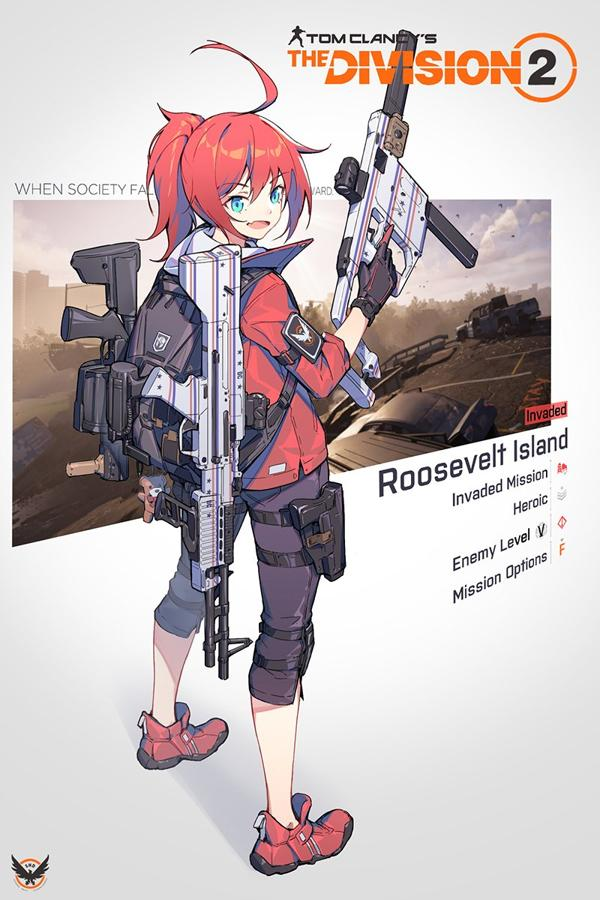

In [11]:
image

In [12]:
image.size

(600, 900)

In [13]:
label_dic={"drawings":0, "hentai": 1,"neutral":2, "porn": 3,"sexy": 4}

In [14]:
processor = ViTImageProcessor.from_pretrained(artifact_dir)
model = ViTForImageClassification.from_pretrained(artifact_dir)


In [15]:
inputs = processor(images=image, return_tensors="np")

In [16]:
inputs['pixel_values'].shape

(1, 3, 224, 224)

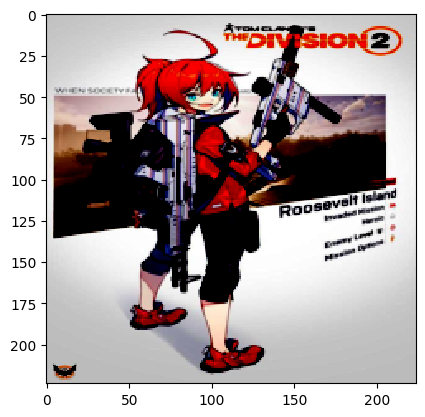

In [17]:
plt.imshow(np.transpose(inputs['pixel_values'][0], (1, 2, 0)), interpolation='nearest')

In [18]:
inputs = processor(images=image, return_tensors="pt")
outputs = model(**inputs)

In [19]:
logits = outputs.logits

In [20]:
predicted_class_idx = logits.argmax(-1).item()
print("Predicted class:", model.config.id2label[predicted_class_idx])

Predicted class: drawings


In [21]:
probs= torch.softmax(logits, dim=1).detach().numpy()

In [22]:
probs

array([[0.9838696 , 0.01054664, 0.0032988 , 0.00122794, 0.00105697]],
      dtype=float32)

In [23]:
def get_key(dict, value):
  for key, val in dict.items():
    if val == value:
      return key
  return "Value not found"





In [24]:
probs = list(probs[0])
probs

[0.9838696, 0.010546636, 0.0032988046, 0.0012279401, 0.0010569658]

In [25]:
for prob, key in zip(probs,range(0,len(probs))):
  label = get_key(label_dic, key)
  print(label, prob)

drawings 0.9838696
hentai 0.010546636
neutral 0.0032988046
porn 0.0012279401
sexy 0.0010569658


In [26]:
image = PImage.open(hentai_image)
inputs = processor(images=image, return_tensors="pt")
outputs = model(**inputs)
logits = outputs.logits
predicted_class_idx = logits.argmax(-1).item()
probs= torch.softmax(logits, dim=1).detach().numpy()
probs = list(probs[0])
print("Predicted class:", model.config.id2label[predicted_class_idx])
for prob, key in zip(probs,range(0,len(probs))):
  label = get_key(label_dic, key)
  print(label, prob)

Predicted class: hentai
drawings 0.0035452377
hentai 0.990712
neutral 0.002092141
porn 0.0020303086
sexy 0.0016203966


In [27]:
image = PImage.open(neutral_image)
inputs = processor(images=image, return_tensors="pt")
outputs = model(**inputs)
logits = outputs.logits
predicted_class_idx = logits.argmax(-1).item()
probs= torch.softmax(logits, dim=1).detach().numpy()
probs = list(probs[0])
print("Predicted class:", model.config.id2label[predicted_class_idx])
for prob, key in zip(probs,range(0,len(probs))):
  label = get_key(label_dic, key)
  print(label, prob)


Predicted class: neutral
drawings 0.07214494
hentai 0.006861157
neutral 0.91743326
porn 0.0015690216
sexy 0.001991645


In [28]:
image = PImage.open(porn_image)
inputs = processor(images=image, return_tensors="pt")
outputs = model(**inputs)
logits = outputs.logits
predicted_class_idx = logits.argmax(-1).item()
probs= torch.softmax(logits, dim=1).detach().numpy()
probs = list(probs[0])
print("Predicted class:", model.config.id2label[predicted_class_idx])
for prob, key in zip(probs,range(0,len(probs))):
  label = get_key(label_dic, key)
  print(label, prob)

Predicted class: porn
drawings 0.0006852749
hentai 0.0009288748
neutral 0.000803191
porn 0.9962076
sexy 0.0013751052


In [29]:
image = PImage.open(sexy_image)
inputs = processor(images=image, return_tensors="pt")
outputs = model(**inputs)
logits = outputs.logits
predicted_class_idx = logits.argmax(-1).item()
probs= torch.softmax(logits, dim=1).detach().numpy()
probs = list(probs[0])
print("Predicted class:", model.config.id2label[predicted_class_idx])
for prob, key in zip(probs,range(0,len(probs))):
  label = get_key(label_dic, key)
  print(label, prob)

Predicted class: sexy
drawings 0.0015199133
hentai 0.0015640532
neutral 0.014665748
porn 0.00344869
sexy 0.9788016


In [30]:
image = PImage.open(drawing_image)
inputs = processor(images=image, return_tensors="pt")
outputs = model(**inputs)
logits = outputs.logits
predicted_class_idx = logits.argmax(-1).item()
probs= torch.softmax(logits, dim=1).detach().numpy()
probs = list(probs[0])
print("Predicted class:", model.config.id2label[predicted_class_idx])
for prob, key in zip(probs,range(0,len(probs))):
  label = get_key(label_dic, key)
  print(label, prob)

Predicted class: drawings
drawings 0.9838696
hentai 0.010546636
neutral 0.0032988046
porn 0.0012279401
sexy 0.0010569658


In [31]:
from transformers import ViTImageProcessor,  ViTForImageClassification
from PIL import Image as PImage
import matplotlib.pyplot as plt
import torch
from datasets import ClassLabel, Dataset, Features, Image, Value, Sequence, DatasetDict
import numpy as np
from IPython.display import Video

In [51]:
path_video= "/content/drive/MyDrive/data/test_images_videos/production_id_3997798 (2160p).mp4"

In [52]:
Video(path_video, embed=True, width=200,    height=200,)

In [53]:
import cv2
from typing import Any, Callable, List, Optional, Sequence, Tuple
from tqdm import tqdm  # type: ignore

In [54]:
import numpy as np
import numpy.typing
from enum import auto, Enum
NDFloat32Array = np.typing.NDArray[np.float32]
NDUInt8Array = np.typing.NDArray[np.uint8]

In [55]:
cap = cv2.VideoCapture(path_video)
fps = cap.get(cv2.CAP_PROP_FPS)
fps

50.0

In [56]:
label_dic={"drawings":0, "hentai": 1,"neutral":2, "porn": 3,"sexy": 4}
processor = ViTImageProcessor.from_pretrained(artifact_dir)
model = ViTForImageClassification.from_pretrained(artifact_dir)
model = model.to("cuda")

video_writer: Optional[cv2.VideoWriter] = None  # pylint: disable=no-member
input_frames: List[NDFloat32Array] = []
nsfw_probability = 0.0
nsfw_probabilities: List[float] = []
frame_count = 0

In [57]:
int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

738

In [58]:
ret, bgr_frame = cap.read()
frame = cv2.cvtColor(bgr_frame, cv2.COLOR_BGR2RGB)

In [59]:
inputs = processor(images=frame, return_tensors="np")
inputs['pixel_values'].shape

(1, 3, 224, 224)

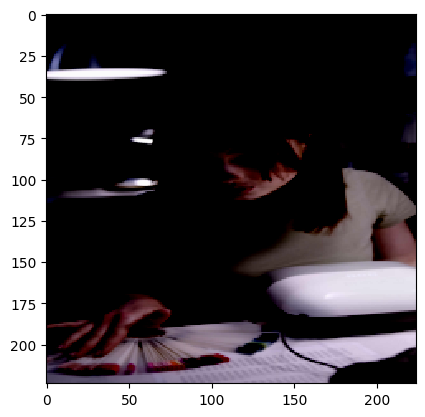

In [60]:
plt.imshow(np.transpose(inputs['pixel_values'][0], (1, 2, 0)), interpolation='nearest')

In [61]:
inputs = processor(images=frame, return_tensors="pt")
inputs =  inputs.to("cuda")
outputs = model(**inputs)

In [62]:
logits = outputs.logits
predicted_class_idx = logits.argmax(-1).item()
print("Predicted class:", model.config.id2label[predicted_class_idx])

Predicted class: neutral


In [63]:
probs= torch.softmax(logits, dim=1).cpu().detach().numpy()
probs = list(probs[0])
probs

[0.04350746, 0.00378744, 0.94535017, 0.0043055476, 0.0030494644]

In [64]:
output_probs = {}
for prob, key in zip(probs,range(0,len(probs))):
  label = get_key(label_dic, key)
  print(label, prob)
  output_probs[label]= prob

drawings 0.04350746
hentai 0.00378744
neutral 0.94535017
porn 0.0043055476
sexy 0.0030494644


In [65]:
# we have define non-suitable for work as the sum of this classes > 0.5 (in fact it is a threshold defined by user)
prob_nsfw = output_probs["sexy"] + output_probs["hentai"] + output_probs["porn"]
prob_nsfw

0.011142451

In [66]:
cap = cv2.VideoCapture(path_video)
pbar = tqdm(total=int(cap.get(cv2.CAP_PROP_FRAME_COUNT)))
video_writer: Optional[cv2.VideoWriter] = None  # pylint: disable=no-member
input_frames: List[NDFloat32Array] = []
nsfw_probability = 0.0
nsfw_probabilities: List[float] = []
frame_count = 0
pbar = tqdm(total=int(cap.get(cv2.CAP_PROP_FRAME_COUNT)))

while cap.isOpened():
    ret, bgr_frame = cap.read()
    if not ret:
            break  # End of given video.
    if pbar is not None:
            pbar.update(1)

    frame_count += 1
    frame = cv2.cvtColor(bgr_frame, cv2.COLOR_BGR2RGB)  # pylint: disable=no-member

    inputs = processor(images=frame, return_tensors="pt")
    inputs =  inputs.to("cuda")
    outputs = model(**inputs)
    logits = outputs.logits
    # get probabilities
    probs= torch.softmax(logits, dim=1).cpu().detach().numpy()
    probs = list(probs[0])
    output_probs = {}
    for prob, key in zip(probs,range(0,len(probs))):
        label = get_key(label_dic, key)
        output_probs[label]= prob
    # probability nsfw
    prob_nsfw = output_probs["sexy"] + output_probs["hentai"] + output_probs["porn"]
    nsfw_probabilities.append(prob_nsfw)


  0%|          | 0/738 [00:00<?, ?it/s]

100%|██████████| 738/738 [01:11<00:00, 10.09it/s]

In [67]:
nsfw_prob = np.array(nsfw_probabilities).mean()
nsfw_prob

0.008041441

In [ ]:
wandb.finish()